In [3]:
import torch
import torch.nn.functional as F
import torch.nn as nn
from torch.utils.data import DataLoader, TensorDataset, random_split
import pickle
import numpy as np
import torch.optim as optim
import matplotlib 
import matplotlib.pyplot as plt
import sys
import os
import pandas as pd
sys.path.append(os.path.abspath(".."))
from Plot_ReceiverFunction import RFProfileData
from symmetric_vae import vae_loss_function, conv_SYMVAE1D_MultiGroup, conv_SYMVAE1D
import random
import seaborn as sns
from collections import defaultdict

In [4]:
import matplotlib
matplotlib.__file__

'/home/aswini/.local/lib/python3.10/site-packages/matplotlib/__init__.py'

# Load pickle file

In [5]:
with open("synthetic_data.pkl", "rb") as f:
    data_dict = pickle.load(f)

In [6]:
data_dict.keys()

dict_keys(['data', 'station', 'evloc', 'staloc', 'ses', 'real'])

In [7]:
len(data_dict["data"][0][0])

1200

# Training of Synthetic Data with Convolutional SymAE

## Chunks wise training

In [30]:
# If number of signals in a bin is very high (exceeds GPU memory),
# we have to divide our bins into smaller chunks,
# making sure that one chunk has signals corresponding to only one bin.
# The chunk size should still be large enough to learn the shared coherent code disentanglement.

### Model, Loss Function and Model Parameters

In [35]:
dis_range = (40,10,90)
baz_range = (0,10,350)
nevt = 35 # Only for synthetic data
nt = 400
z_dim_coh = 300
z_dim_nui = 20
beta = 1
nepochs = 10
lr = 1e-3
device = torch.device("cuda:0")
model = conv_SYMVAE1D_MultiGroup(z_dim_coh=z_dim_coh, z_dim_nui = z_dim_nui, nt = nt )

### Load Data


In [36]:
data = [ [arr[400:800] for arr in sta_data] for sta_data in data_dict["data"]]  #Extract only vertical component (400:800 of the array)
data = np.array(data)

In [37]:
dis_bins = np.arange(dis_range[0], dis_range[2] + dis_range[1], dis_range[1])
baz_bins = np.arange(baz_range[0], baz_range[2] + baz_range[1], baz_range[1])
print(dis_bins)
print(baz_bins)
nbaz = len(baz_bins)
ndis = len(dis_bins)
print(nbaz, ndis)
bins = defaultdict(list)

[40 50 60 70 80 90]
[  0  10  20  30  40  50  60  70  80  90 100 110 120 130 140 150 160 170
 180 190 200 210 220 230 240 250 260 270 280 290 300 310 320 330 340 350]
36 6


In [51]:
for s in range(len(data)):
    s_data = data[s]
    s_data = s_data.reshape(nbaz, nevt*ndis,nt )
    for b in range(nbaz):
        baz_data = s_data[b , :, :]
        baz_data = baz_data.reshape(ndis, nevt, nt)
        for d in range(ndis):
            no = np.random.randint(25,35)  # Sample random 25-35 RFs from bin 
            # no = 35
            dis_baz_data = baz_data[d, 0:no, :]
            dis_bin = dis_bins[d ]  
            baz_bin = baz_bins[b ]
            key = f"{s+1}_{baz_bin}_{dis_bin}"
            bins[key] = list(dis_baz_data)

In [52]:
profile_alldata = RFProfileData()

In [53]:
# all_bins = profile_alldata._bin_and_stack(data = data, stations = data_dict["station"] , evloc = data_dict["evloc"],
#                                           staloc =  data_dict["staloc"],
#                                           mag_thre=4.5, snr_thre=0.0,
#                                            epi_range=(30, 10, 100), baz_range=(0, 10, 360) )
# print(len(all_bins))

all_bins = profile_alldata.bins = bins
print(len(all_bins))

1296


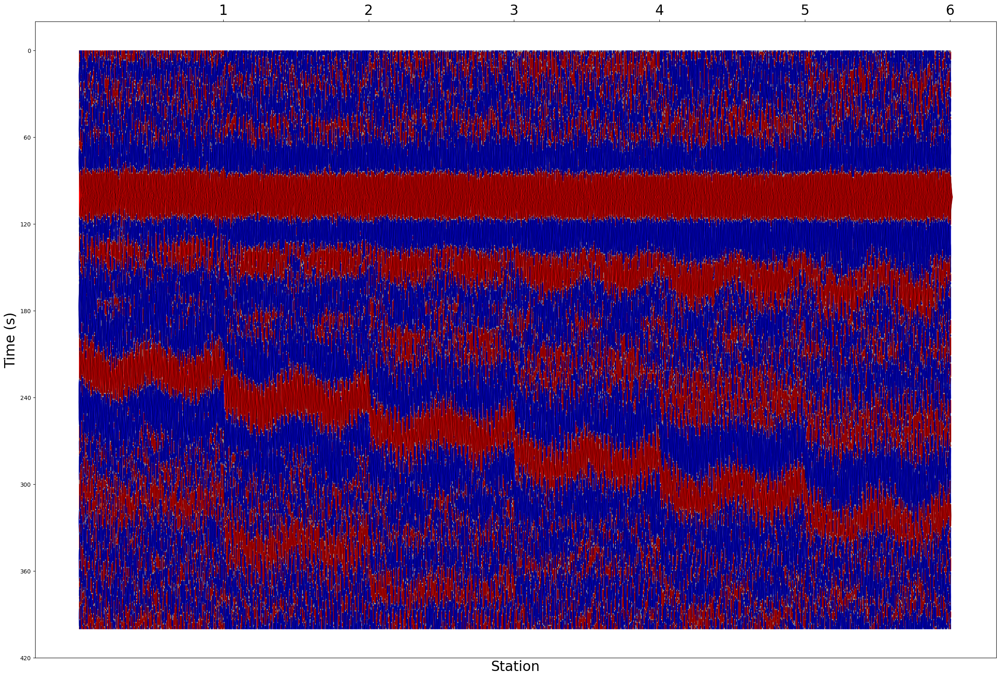

In [54]:
fig, ax = profile_alldata._plot_binned_stacked(scaling=2.0, spacing=5, figsize=(30, 20))
fig.patch.set_facecolor("white")  # To ensure axis labels are visible
display(fig)

In [55]:
# We want all back azimuth with specified epicentral distance to test our model (epicentral distance 40 in this case)
# But we train on entire data
fixdis_profile = RFProfileData()

for key in profile_alldata.bins.keys():
    if key.endswith("40"):
        fixdis_profile.bins[key] = profile_alldata.bins[key] 

print(len(fixdis_profile.bins))

216


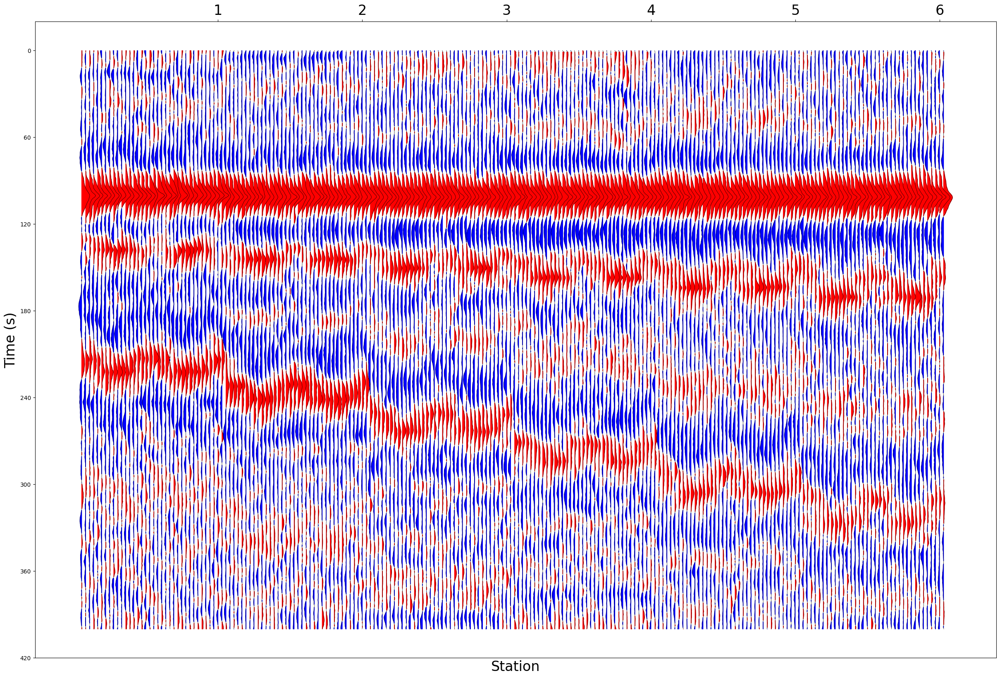

In [56]:
fig, ax = fixdis_profile._plot_binned_stacked(scaling=2.0, spacing=5, figsize=(30, 20))
fig.patch.set_facecolor("white")  # To ensure axis labels are visible
display(fig)

In [57]:
groups = []
group_size = 15  # 15 Rfs in every chunk (group)
for bin_data in list(profile_alldata.bins.values()):
    if len(bin_data) >= group_size:
        for i in range(0,len(bin_data), group_size):
            group_data = bin_data[i:i+group_size]
            if len(group_data) != group_size:
                continue
            for j,rf in enumerate(group_data):
                rf_norm = (rf)/(np.std(rf))
                group_data[j] = rf_norm
            # group_data 
            groups.append(group_data) 

In [58]:
groups = torch.tensor(groups, dtype=torch.float32)
print(groups.shape)
groups = groups.unsqueeze(2)
print(groups.shape)
# groups = (groups - groups.min() )/ (groups.max() - groups.min())

torch.Size([1953, 15, 400])
torch.Size([1953, 15, 1, 400])


In [59]:
print(groups.max(), groups.min())

tensor(10.5835) tensor(-4.3138)


In [60]:
dataset = TensorDataset(groups)
train_ratio = 0.8
train_size = int(train_ratio * len(dataset))
test_size = len(dataset) - train_size
print("train_size",train_size,"test_size", test_size)
train_dataset, test_dataset = random_split(dataset, [train_size, test_size])
batch_size = 8
train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
test_loader = DataLoader(test_dataset, batch_size=batch_size, shuffle=False)

train_size 1562 test_size 391


### Define Trining Loop

In [61]:
def train_vae(model, train_loader, test_loader, epochs=20, lr=1e-3, device = "cpu"):    
    optimizer = optim.Adam(model.parameters(), lr=lr)
    model.to(device)
    history = []
    for epoch in range(1, epochs + 1):
        model.train()
        train_loss = 0
        train_mse_total = 0
        for batch in train_loader:
            x = batch[0].to(device)
            optimizer.zero_grad()
            output = model(x)
            batch_size, group_size  = x.shape[0], x.shape[1]
            recon,mu,logvar = output["recon"], output["mu"], output["logvar"]
            losses = vae_loss_function(output["recon"], x, output["mu"], output["logvar"], beta = 1)
            loss, recon_loss, kl_loss = losses["total_loss"], losses["recon_mse"], losses["Dkl"]
            loss.backward()
            torch.nn.utils.clip_grad_norm_(model.parameters(), max_norm=1.0)
            optimizer.step()

            train_loss += loss.item()
            train_mse_total += F.mse_loss(recon, x, reduction="mean").item()

        avg_train_loss = train_loss / len(train_loader.dataset)
        avg_train_mse = train_mse_total / len(train_loader.dataset)

        #Evaluation
        model.eval()
        test_loss = 0
        test_mse_total = 0
        with torch.no_grad():
            for batch in test_loader:
                x = batch[0].to(device)
                output = model(x)
                
                recon,mu,logvar = output["recon"], output["mu"], output["logvar"]
                batch_size, group_size  = x.shape[0], x.shape[1]
                losses = vae_loss_function(output["recon"], x, output["mu"], output["logvar"], beta = 1)
                loss, recon_loss, kl_loss = losses["total_loss"], losses["recon_mse"], losses["Dkl"]
                test_loss += loss.item()
                test_mse_total += F.mse_loss(recon, x, reduction="mean").item()

        avg_test_loss = test_loss / len(test_loader.dataset)
        avg_test_mse = test_mse_total / len(test_loader.dataset)
        
        print(f"Epoch [{epoch}/{epochs}] " 
                f"Train Loss: {avg_train_loss:.4f} " 
                f"Test Loss: {avg_test_loss:.4f} " 
                f"Train MSE: {avg_train_mse:.6f} " 
                f"Test MSE: {avg_test_mse:.6f}")
        
        history.append({
                "epoch": epoch,
                "train_loss": avg_train_loss,
                "test_loss": avg_test_loss,
                "train_mse": avg_train_mse,
                "test_mse": avg_test_mse
                })

    
        df = pd.DataFrame(history)
    
    #Plot Loss (KL + MSE)
    plt.figure(figsize=(10, 4))
    plt.plot(df["epoch"], df["train_loss"], label="Train Loss")
    plt.plot(df["epoch"], df["test_loss"], label="Test Loss")
    plt.xlabel("Epoch")
    plt.ylabel("Loss")
    plt.title("Loss vs Epoch")
    plt.legend()
    plt.show()
    
    # Plot MSE
    plt.figure(figsize=(10, 4))
    plt.plot(df["epoch"], df["train_mse"], label="Train MSE")
    plt.plot(df["epoch"], df["test_mse"], label="Test MSE")
    plt.xlabel("Epoch")
    plt.ylabel("MSE")
    plt.title("MSE vs Epoch")
    plt.legend()
    plt.show()

In [62]:
for i in range(torch.cuda.device_count()):
    print(i, torch.cuda.get_device_name(i))

0 NVIDIA RTX A6000
1 NVIDIA GeForce RTX 3090


### Train

Epoch [1/10] Train Loss: 6623.0045 Test Loss: 5206.5939 Train MSE: 0.112316 Test MSE: 0.107522
Epoch [2/10] Train Loss: 5056.7930 Test Loss: 4897.1283 Train MSE: 0.104248 Test MSE: 0.100055
Epoch [3/10] Train Loss: 4620.5585 Test Loss: 4375.9851 Train MSE: 0.093136 Test MSE: 0.087224
Epoch [4/10] Train Loss: 4137.4384 Test Loss: 3983.5613 Train MSE: 0.081098 Test MSE: 0.077471
Epoch [5/10] Train Loss: 3878.5825 Test Loss: 3821.8036 Train MSE: 0.074978 Test MSE: 0.074031
Epoch [6/10] Train Loss: 3709.5148 Test Loss: 3693.1740 Train MSE: 0.071048 Test MSE: 0.070451
Epoch [7/10] Train Loss: 3642.7056 Test Loss: 3644.0532 Train MSE: 0.069516 Test MSE: 0.069652
Epoch [8/10] Train Loss: 3612.6441 Test Loss: 3615.5941 Train MSE: 0.068896 Test MSE: 0.069152
Epoch [9/10] Train Loss: 3536.2170 Test Loss: 3523.1584 Train MSE: 0.066987 Test MSE: 0.066702
Epoch [10/10] Train Loss: 3510.8135 Test Loss: 3543.6730 Train MSE: 0.066330 Test MSE: 0.067387


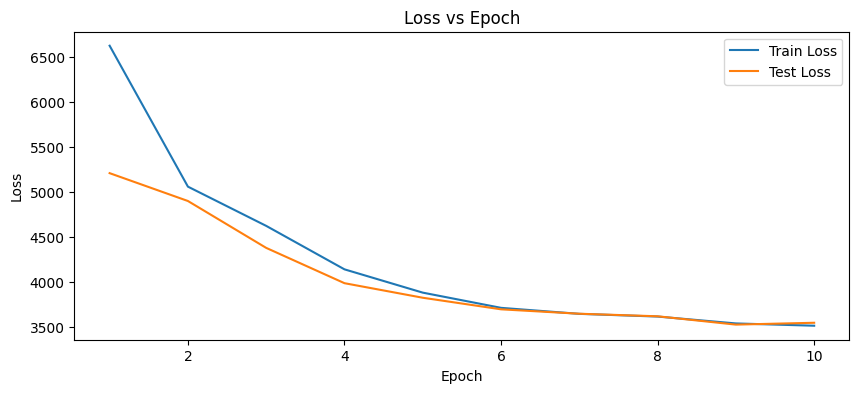

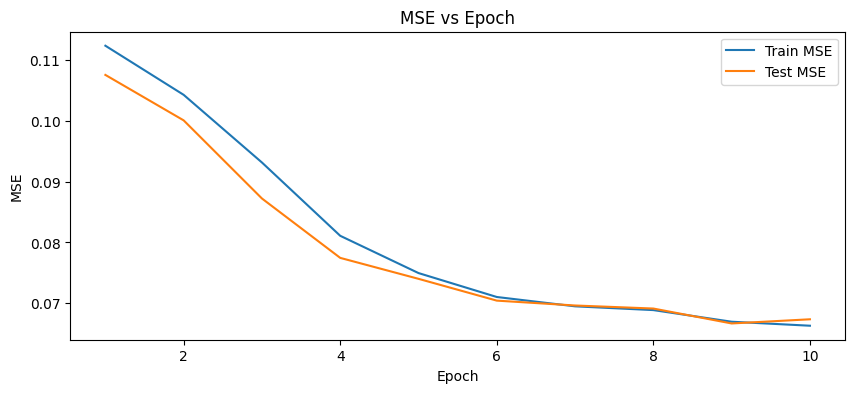

In [64]:
train_vae(model, train_loader, test_loader, epochs = nepochs, lr = lr, device = device)

### Test and Eval

In [65]:
eval_profile = fixdis_profile
# eval_profile = profile_alldata

In [66]:
mu_nui, logvar_nui, mu_coh , logvar_coh, c_mu_coh, c_logvar_coh = [],[],[],[],[],[]
sample_recon, sample_ori = [],[]
group_size = 20
with torch.no_grad():
    for batch in groups:
        batch = batch.unsqueeze(0)
        batch = batch.to(device)
        output = model(batch)
        mu_nui.append(output["mu_nui"].cpu())
        logvar_nui.append(output["logvar_nui"].cpu())
        mu_coh.append(output["mu_coh"].cpu())
        logvar_coh.append(output["logvar_coh"].cpu())
        recon = output["recon"]
        for i  in range(len(batch)):
            c_mu_coh.append(output["mu"][i*group_size , : model.encoderCoh.z_dim].cpu())
            c_logvar_coh.append(output["logvar"][i*group_size , : model.encoderCoh.z_dim].cpu())
        
        idx = random.randint(0, len(recon)-1)
        idx2 = random.randint(0, len(recon[0])-1)
        sample_recon_rf = recon[idx, idx2]
        sample_rf = batch[idx, idx2]
        # print(sample_recon_rf.shape, sample_rf.shape)
        sample_recon.append(sample_recon_rf)
        sample_ori.append(sample_rf)
        # break
sample_recon = torch.stack(sample_recon)
sample_ori = torch.stack(sample_ori)
sample_recon = sample_recon.squeeze(1).cpu()
sample_ori = sample_ori.squeeze(1).cpu()

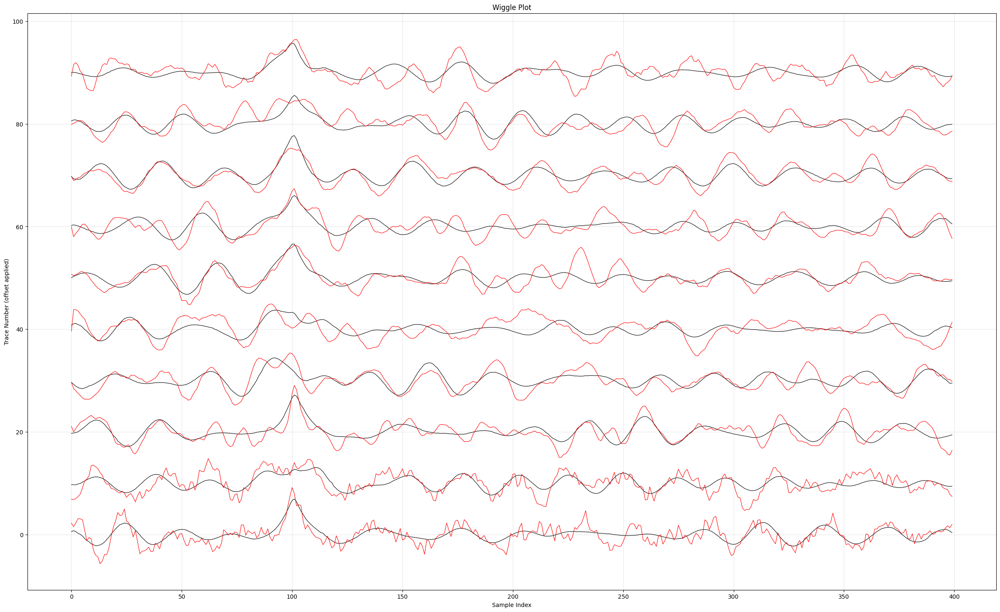

In [67]:
# Random n samples from test set are plotted
n_samples = 10
indices = sorted(random.sample(range(len(sample_recon)), n_samples))
plt.figure(figsize=(30, 18))
scaling = 2
spacing = 10  
for i,trace in enumerate(zip([sample_recon[i] for i in indices], [sample_ori[i] for i in indices])):
    # reconstructed in black
    plt.plot(trace[0]*scaling + i * spacing, color="black", linewidth=0.8)
    # original in red
    plt.plot(trace[1]*scaling + i * spacing, color = "red", linewidth = 0.8)

plt.xlabel("Sample Index")
plt.ylabel("Trace Number (offset applied)")
plt.title("Wiggle Plot")
plt.grid(True, alpha=0.3)
plt.show()

### Latent Space Testing

In [68]:
mu_coh = np.vstack(mu_coh)
logvar_coh = np.vstack(logvar_coh)
mu_nui = np.vstack(mu_nui)
logvar_nui = np.vstack(logvar_nui)
var_coh = np.exp(logvar_coh)
var_nui = np.exp(logvar_nui)
c_mu_coh = np.vstack(c_mu_coh)
c_logvar_coh = np.vstack(c_logvar_coh)

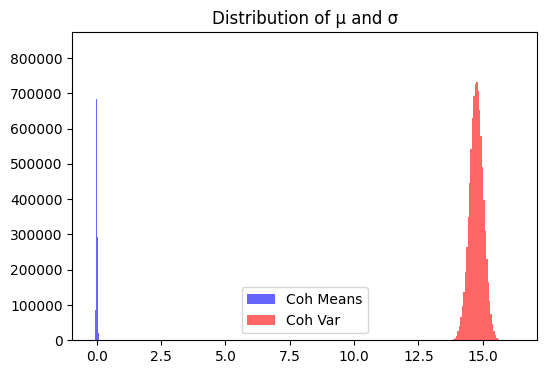

In [69]:
plt.figure(figsize=(6,4))
plt.hist(mu_coh.flatten(), bins=50, alpha=0.6, color="blue",   label="Coh Means")
plt.hist(var_coh.flatten(), bins=50, alpha=0.6, color="red",    label="Coh Var")
plt.legend()
plt.title("Distribution of μ and σ")
plt.show()

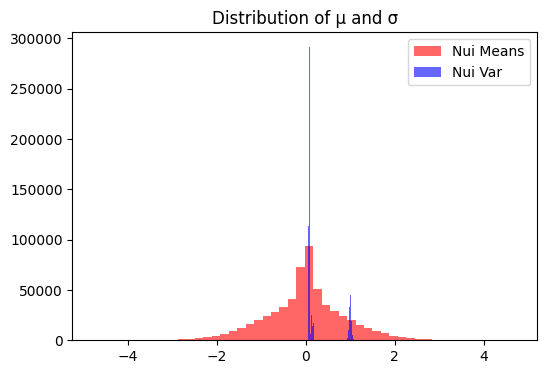

In [70]:
plt.figure(figsize=(6,4))
plt.hist(mu_nui.flatten(), bins=50, alpha=0.6, color="red",   label="Nui Means")
plt.hist(var_nui.flatten(), bins=50, alpha=0.6, color="blue", label="Nui Var")
plt.legend()
plt.title("Distribution of μ and σ")
plt.show()

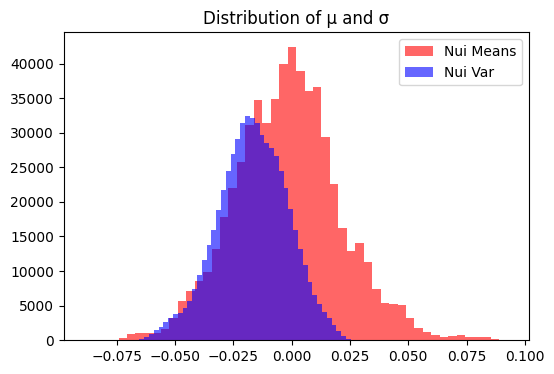

In [71]:
plt.figure(figsize=(6,4))
plt.hist(c_mu_coh.flatten(), bins=50, alpha=0.6, color="red",   label="Nui Means")
plt.hist(c_logvar_coh.flatten(), bins=50, alpha=0.6, color="blue", label="Nui Var")
plt.legend()
plt.title("Distribution of μ and σ")
plt.show()

### Demeaning 

In [72]:
# Function to calculate KL divergence between nui code and corresponding coherent code
def kl_diag_normals(mu_coh, logvar_coh, mu_nui, logvar_nui):
    mu_coh = mu_coh.double()
    mu_nui = mu_nui.double()
    logvar_coh = logvar_coh.double()
    logvar_nui = logvar_nui.double()
    var_coh = torch.exp(logvar_coh)
    var_nui = torch.exp(logvar_nui)
    term = logvar_nui - logvar_coh + (var_coh + (mu_coh - mu_nui).pow(2)) / var_nui - 1.0
    kl = 0.5 * term.mean(dim=-1)
    return kl

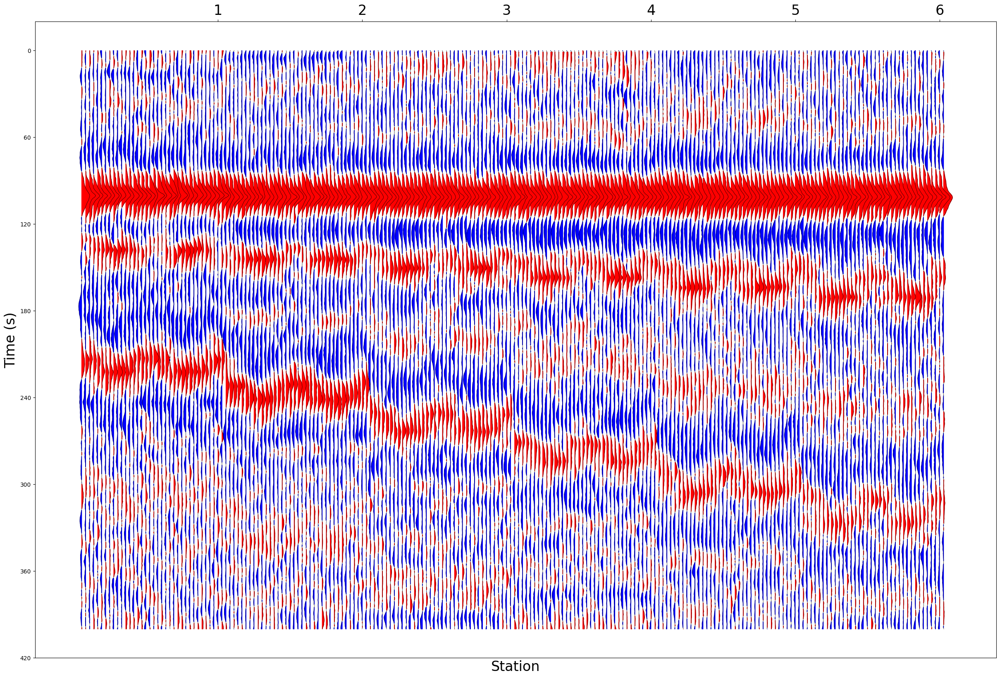

In [73]:
fig, ax = fixdis_profile._plot_binned_stacked(scaling=2.0, spacing=5, figsize=(30, 20))
fig.patch.set_facecolor("white")  # To ensure axis labels are visible
display(fig)

In [74]:
len(fixdis_profile.bins)

216

In [75]:
#To find optimum nuisance code within our receiver function

min_kl = torch.tensor(float('inf'))
model.eval()
with torch.no_grad():
    for batch in list(eval_profile.bins.values()):
        batch = torch.tensor(batch, dtype=torch.float32)
        batch = batch.to(device)
        batch = batch.unsqueeze(0)
        batch = batch.unsqueeze(2)
        output = model(batch)
        mu = output["mu"]
        mu_coh = output["mu_coh"]
        mu_nui = output["mu_nui"]
        logvar = output["logvar"]
        logvar_coh = output["logvar_coh"]
        logvar_nui = output["logvar_nui"]
        # c_mu_coh = output["c_mu_coh"].squeeze(0)
        # c_logvar_coh = output["c_logvar_coh"].squeeze(0)
        c_mu_coh = output["mu"][0][: model.encoderCoh.z_dim]
        c_logvar_coh = output["logvar"][0][: model.encoderCoh.z_dim]
        
        # print(output["mu"].shape)
        c_mu_coh = c_mu_coh.repeat(len(batch[0]), 1)
        c_logvar_coh = c_logvar_coh.repeat(len(batch[0]), 1)
        # print(c_mu_coh.shape, mu_coh.shape, c_logvar_coh.shape)
        kl = kl_diag_normals(c_mu_coh, c_logvar_coh, mu_coh, logvar_coh)
        argmin =  torch.argmin(kl)
        if (kl[argmin] < min_kl):
            print(kl[argmin])
            min_kl = kl[argmin]
            opti_mu = mu_nui[argmin]
            opti_logvar = mu_nui[argmin]
        # break

tensor(1.2032, device='cuda:0', dtype=torch.float64)
tensor(1.1844, device='cuda:0', dtype=torch.float64)
tensor(1.1543, device='cuda:0', dtype=torch.float64)
tensor(1.1293, device='cuda:0', dtype=torch.float64)
tensor(1.1169, device='cuda:0', dtype=torch.float64)
tensor(1.1167, device='cuda:0', dtype=torch.float64)
tensor(1.1134, device='cuda:0', dtype=torch.float64)
tensor(1.1129, device='cuda:0', dtype=torch.float64)
tensor(1.1124, device='cuda:0', dtype=torch.float64)
tensor(1.1100, device='cuda:0', dtype=torch.float64)


In [76]:
model.eval()
from collections import defaultdict
bins_recon = defaultdict(list)
with torch.no_grad():
    for key, batch in list(eval_profile.bins.items()):
        batch_ = torch.tensor(batch, dtype=torch.float32)
        batch_ = batch_.to(device)
        batch_ = batch_.unsqueeze(0)
        batch_ = batch_.unsqueeze(2)
        batch_size, group_size, c, nt = batch_.size()
        batch_ = batch_.view(batch_size * group_size, c, nt)
        
        mu_coh, logvar_coh = model.encoderCoh(batch_)
        mu_coh_ = mu_coh.view(batch_size, group_size, model.encoderCoh.z_dim)
        logvar_coh_ = logvar_coh.view(batch_size, group_size, model.encoderCoh.z_dim)
        
        c_mu_coh, c_logvar_coh = model.accumulate_Gaussians(mu_coh_, logvar_coh_)
        
        c_mu_coh = c_mu_coh.view(model.encoderCoh.z_dim)
        c_logvar_coh = c_logvar_coh.view(model.encoderCoh.z_dim)
        
        mu = torch.cat([c_mu_coh, opti_mu], dim=0)
        logvar = torch.cat([c_logvar_coh, opti_logvar], dim=0)
        z = model.reparameterize(mu, logvar)
        z = z.view(batch_size, z.shape[0])
        recon = model.decoder(z) 
        recon = recon.view(model.nt)  
        bins_recon[key].append(recon.cpu().numpy())
        # break
        # print(key,type(batch), len(batch), batch_.shape, z.shape, recon.shape)     

In [77]:
recon_profile = RFProfileData()
recon_profile.bins = bins_recon

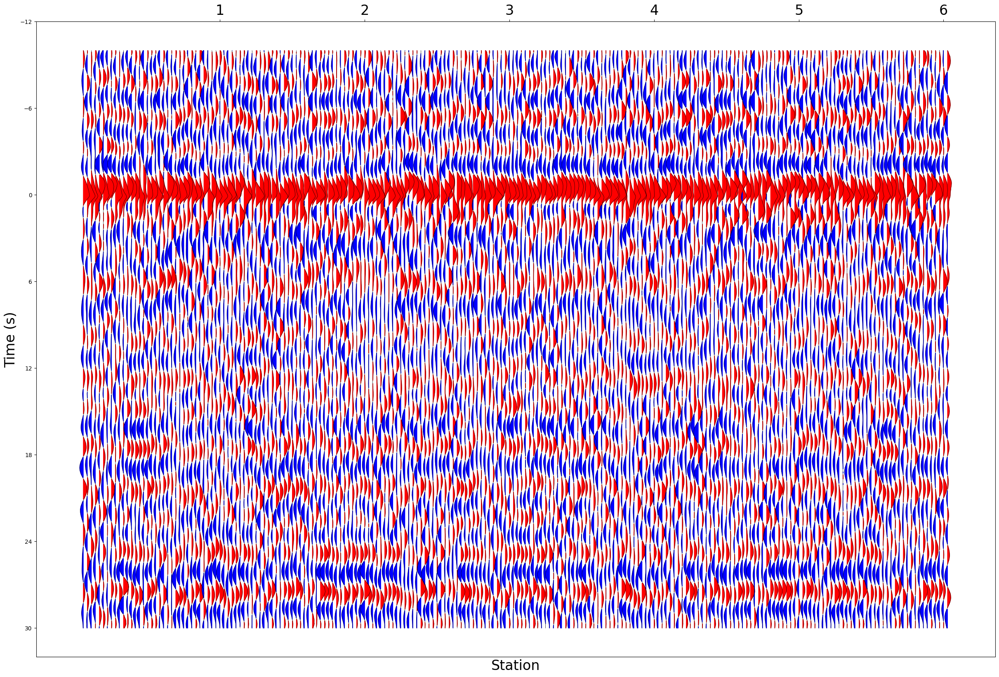

In [78]:
fig, ax = recon_profile._plot_binned_stacked(shift=10, time_after=30,nsamples = model.nt,scaling=2, spacing=5, figsize=(30, 20))
fig.patch.set_facecolor("white")
display(fig)

In [79]:
mean = np.mean(np.concatenate([arr for v in bins_recon.values() for arr in v]))
print(mean)

0.044291735


In [80]:
model.eval()
from collections import defaultdict
bins_recon = defaultdict(list)
with torch.no_grad():
    for key, batch in list(eval_profile.bins.items()):
        batch_ = torch.tensor(batch, dtype=torch.float32)
        batch_ = batch_.to(device)
        batch_ = batch_.unsqueeze(0)
        batch_ = batch_.unsqueeze(2)
        batch_size, group_size, c, nt = batch_.size()
        batch_ = batch_.view(batch_size * group_size, c, nt)
        
        mu_coh, logvar_coh = model.encoderCoh(batch_)
        mu_coh_ = mu_coh.view(batch_size, group_size, model.encoderCoh.z_dim)
        logvar_coh_ = logvar_coh.view(batch_size, group_size, model.encoderCoh.z_dim)
        
        c_mu_coh, c_logvar_coh = model.accumulate_Gaussians(mu_coh_, logvar_coh_)
        
        c_mu_coh = c_mu_coh.view(model.encoderCoh.z_dim)
        c_logvar_coh = c_logvar_coh.view(model.encoderCoh.z_dim)
        
        mu = torch.cat([c_mu_coh, opti_mu], dim=0)
        logvar = torch.cat([c_logvar_coh, opti_logvar], dim=0)
        z = model.reparameterize(mu, logvar)
        z = z.view(batch_size, z.shape[0])
        recon = model.decoder(z) 
        recon = recon.view(model.nt)  
        bins_recon[key].append(recon.cpu().numpy() - mean)
        # break
        # print(key,type(batch), len(batch), batch_.shape, z.shape, recon.shape)     

In [81]:
demean_profile = RFProfileData()
demean_profile.bins = bins_recon

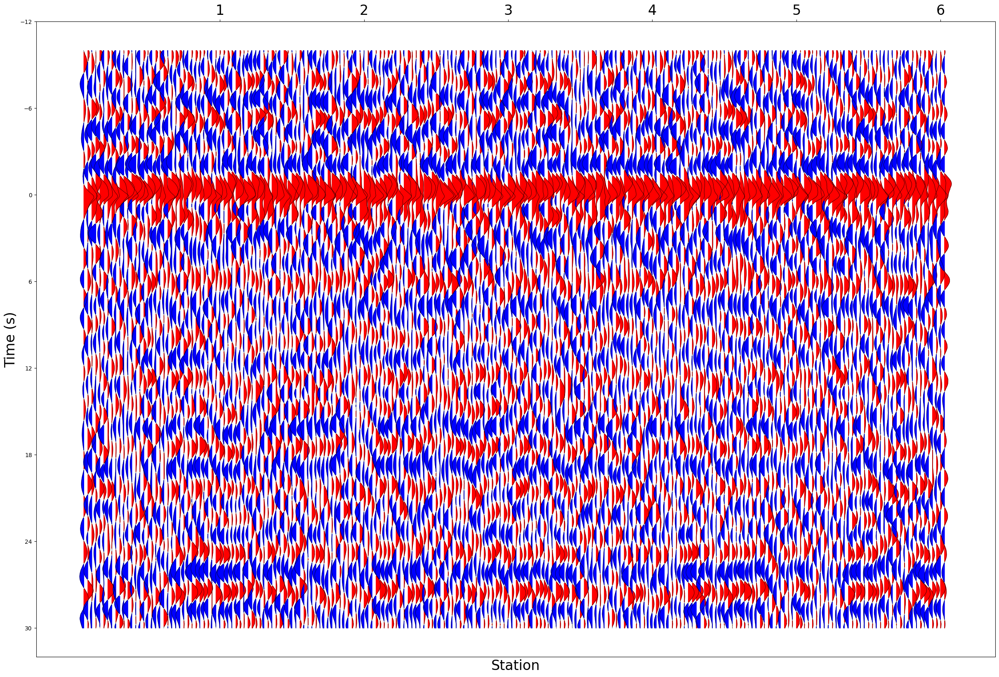

In [82]:
fig, ax = demean_profile._plot_binned_stacked(shift=10, time_after=30,nsamples = model.nt,scaling=3, spacing=5, figsize=(30, 20))
fig.patch.set_facecolor("white")
display(fig)

## Bin wise (all data within bin without using chunks of the bins )

In [125]:
# If memory is sufficient to process all the bins of a batch in a single pass,
# we do not need to split the data into chunks.

### model_parameters 

In [96]:
dis_range = (40,10,90)
baz_range = (0,10,350)
nevt = 35 # Only for synthetic data
nt = 400
z_dim_coh = 300
z_dim_nui = 20
beta = 1
nepochs = 10
lr = 1e-3
device = torch.device("cuda:0")
model = conv_SYMVAE1D_MultiGroup(z_dim_coh=z_dim_coh, z_dim_nui = z_dim_nui)

### Load data

In [97]:
data = [ [arr[400:800] for arr in sta_data] for sta_data in data_dict["data"]]  #Extract only vertical component
data = np.array(data)

In [98]:
dis_bins = np.arange(dis_range[0], dis_range[2] + dis_range[1], dis_range[1])
baz_bins = np.arange(baz_range[0], baz_range[2] + baz_range[1], baz_range[1])
print(dis_bins)
print(baz_bins)
nbaz = len(baz_bins)
ndis = len(dis_bins)
print(nbaz, ndis)
bins = defaultdict(list)

[40 50 60 70 80 90]
[  0  10  20  30  40  50  60  70  80  90 100 110 120 130 140 150 160 170
 180 190 200 210 220 230 240 250 260 270 280 290 300 310 320 330 340 350]
36 6


In [99]:
for s in range(len(data)):
    s_data = data[s]
    s_data = s_data.reshape(nbaz, nevt*ndis,nt )
    for b in range(nbaz):
        baz_data = s_data[b , :, :]
        baz_data = baz_data.reshape(ndis, nevt, nt)
        for d in range(ndis):
            no = np.random.randint(15,35)
            # no = 35
            dis_baz_data = baz_data[d, 0:no, :]
            dis_bin = dis_bins[d ]  
            baz_bin = baz_bins[b ]
            key = f"{s+1}_{baz_bin}_{dis_bin}"
            bins[key] = list(dis_baz_data)

In [100]:
profile_alldata = RFProfileData()

In [101]:
all_bins = profile_alldata.bins = bins
print(len(all_bins))

1296


In [102]:
i = 0
for key in profile_alldata.bins.keys():
    i = i + len(profile_alldata.bins[key])
print(i)

31587


In [103]:
# fig, ax = profile_alldata._plot_binned_stacked(scaling=2.0, spacing=5, figsize=(30, 20))
# fig.patch.set_facecolor("white")  # To ensure axis labels are visible
# display(fig)

In [104]:
# We want all back azimuth with specified epicentral distance to train and test our model 
fixdis_profile = RFProfileData()

for key in profile_alldata.bins.keys():
    if key.endswith("40"):
        fixdis_profile.bins[key] = profile_alldata.bins[key] 

print(len(fixdis_profile.bins))

216


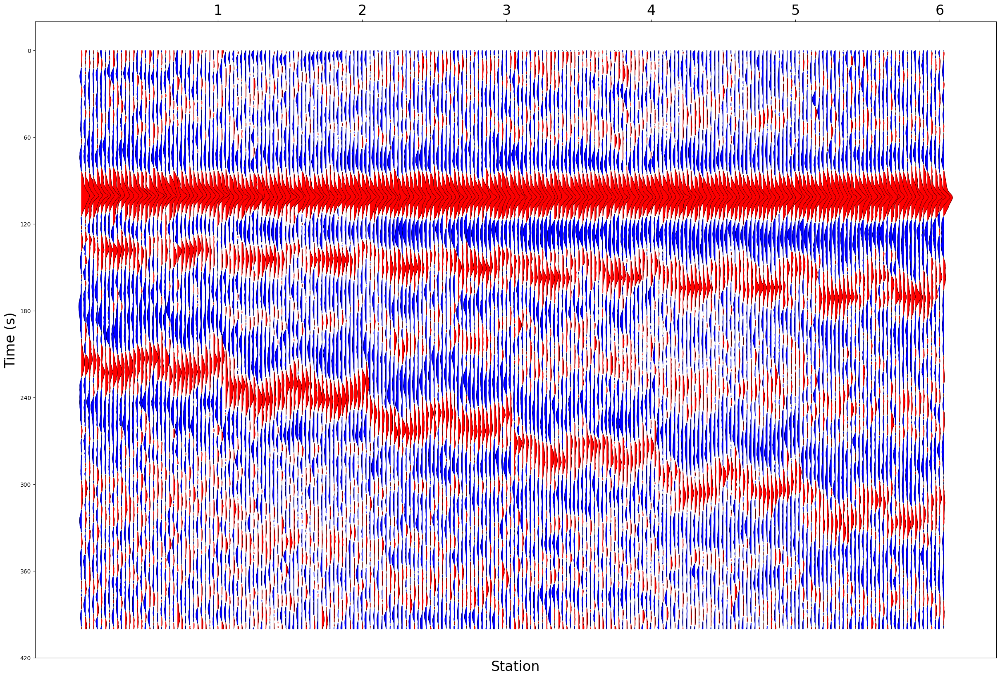

In [105]:
fig, ax = fixdis_profile._plot_binned_stacked(scaling=2.0, spacing=5, figsize=(30, 20))
fig.patch.set_facecolor("white")  # To ensure axis labels are visible
display(fig)

In [106]:
groups = []
group_size = 20
for bin_data in list(profile_alldata.bins.values()):
        group_data = bin_data
        for j,rf in enumerate(group_data):
            rf_norm = (rf)/(np.std(rf))
                # rf_norm = (rf-rf.min()) / (rf.max()-rf.min())
            group_data[j] = rf_norm
            # group_data 
        groups.append(group_data) 

In [107]:
train_ratio = 0.85
train_size = int(train_ratio * len(groups))
print(train_size)
test_size = len(groups) - train_size
print(test_size)
train_dataset, test_dataset = random_split(groups, [train_size, test_size])
batch_size = 1
train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
test_loader = DataLoader(test_dataset, batch_size=batch_size, shuffle=False)

1101
195


### Define training loo

In [108]:
def train_vae(model, train_loader, test_loader, epochs=20, lr=1e-3, device = "cpu"):    
    optimizer = optim.Adam(model.parameters(), lr=lr)
    model.to(device)
    history = []
    for epoch in range(1, epochs + 1):
        #Train
        model.train()
        train_loss = 0
        train_mse_total = 0
        for batch in train_loader:
            x = torch.vstack(batch).to(torch.float32).to(device)
            x = x.unsqueeze(0)
            x = x.unsqueeze(2)
            # x = batch[0].to(device)
            optimizer.zero_grad()
            output = model(x)
            batch_size, group_size  = x.shape[0], x.shape[1]
        
            
            recon,mu,logvar = output["recon"], output["mu"], output["logvar"]
            losses = vae_loss_function(output["recon"], x, output["mu"], output["logvar"], beta = 1)
            # losses = vae_loss_function(output["recon"], x, output["mu"], output["logvar"], output["mu_coh"], output["logvar_coh"],
                        # lmda_mu = 5, lmda_logvar= 5, beta = 1, batch_size = batch_size, group_size = group_size)
            loss, recon_loss, kl_loss = losses["total_loss"], losses["recon_mse"], losses["Dkl"]
            loss.backward()
            torch.nn.utils.clip_grad_norm_(model.parameters(), max_norm=1.0)
            optimizer.step()

            train_loss += loss.item()
            train_mse_total += F.mse_loss(recon, x, reduction="mean").item()

        avg_train_loss = train_loss / len(train_loader.dataset)
        avg_train_mse = train_mse_total / len(train_loader.dataset)

        #Evaluation
        model.eval()
        test_loss = 0
        test_mse_total = 0
        with torch.no_grad():
            for batch in test_loader:
                x = torch.vstack(batch).to(torch.float32).to(device)
                x = x.unsqueeze(0)
                x = x.unsqueeze(2)
                # x = batch[0].to(device)
                output = model(x.to(device))
                
                recon,mu,logvar = output["recon"], output["mu"], output["logvar"]
                batch_size, group_size  = x.shape[0], x.shape[1]
                losses = vae_loss_function(output["recon"], x, output["mu"], output["logvar"], beta = beta)
                # losses = vae_loss_function(output["recon"], x, output["mu"], output["logvar"], output["mu_coh"], output["logvar_coh"],
                        # lmda_mu = 5, lmda_logvar= 5, beta = 1, batch_size = batch_size, group_size = group_size)
                loss, recon_loss, kl_loss = losses["total_loss"], losses["recon_mse"], losses["Dkl"]
                test_loss += loss.item()
                test_mse_total += F.mse_loss(recon, x, reduction="mean").item()

        avg_test_loss = test_loss / len(test_loader.dataset)
        avg_test_mse = test_mse_total / len(test_loader.dataset)
        
        # history["loss"].append(avg_test_loss)
        print(f"Epoch [{epoch}/{epochs}] " 
                f"Train Loss: {avg_train_loss:.4f} " 
                f"Test Loss: {avg_test_loss:.4f} " 
                f"Train MSE: {avg_train_mse:.6f} " 
                f"Test MSE: {avg_test_mse:.6f}")
        
        history.append({
                "epoch": epoch,
                "train_loss": avg_train_loss,
                "test_loss": avg_test_loss,
                "train_mse": avg_train_mse,
                "test_mse": avg_test_mse
                })

        # Convert to DataFrame for easy plotting
        df = pd.DataFrame(history)

        # Plot Loss
    plt.figure(figsize=(8, 3))
    plt.plot(df["epoch"], df["train_loss"], label="Train Loss")
    plt.plot(df["epoch"], df["test_loss"], label="Test Loss")
    plt.xlabel("Epoch")
    plt.ylabel("Loss")
    plt.title("Loss vs Epoch")
    plt.legend()
    plt.show()
    
    # Plot MSE
    plt.figure(figsize=(8, 3))
    plt.plot(df["epoch"], df["train_mse"], label="Train MSE")
    plt.plot(df["epoch"], df["test_mse"], label="Test MSE")
    plt.xlabel("Epoch")
    plt.ylabel("MSE")
    plt.title("MSE vs Epoch")
    plt.legend()
    plt.show()


### Train

Epoch [1/10] Train Loss: 9057.9099 Test Loss: 8166.7804 Train MSE: 0.857693 Test MSE: 0.826136
Epoch [2/10] Train Loss: 8100.3997 Test Loss: 7671.9768 Train MSE: 0.792574 Test MSE: 0.764401
Epoch [3/10] Train Loss: 7206.6319 Test Loss: 6713.6552 Train MSE: 0.684289 Test MSE: 0.631325
Epoch [4/10] Train Loss: 6539.8662 Test Loss: 6343.5602 Train MSE: 0.606836 Test MSE: 0.600569
Epoch [5/10] Train Loss: 6376.4571 Test Loss: 6165.4857 Train MSE: 0.590469 Test MSE: 0.585734
Epoch [6/10] Train Loss: 6217.8115 Test Loss: 6014.5509 Train MSE: 0.571141 Test MSE: 0.560402
Epoch [7/10] Train Loss: 6102.5089 Test Loss: 5978.0226 Train MSE: 0.557838 Test MSE: 0.557386
Epoch [8/10] Train Loss: 6063.7800 Test Loss: 5938.9604 Train MSE: 0.553305 Test MSE: 0.555119
Epoch [9/10] Train Loss: 6037.9935 Test Loss: 6012.3937 Train MSE: 0.550388 Test MSE: 0.554246
Epoch [10/10] Train Loss: 6028.5734 Test Loss: 5909.4404 Train MSE: 0.550170 Test MSE: 0.550973


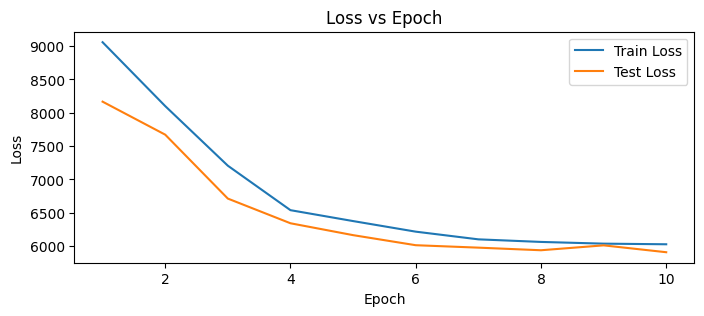

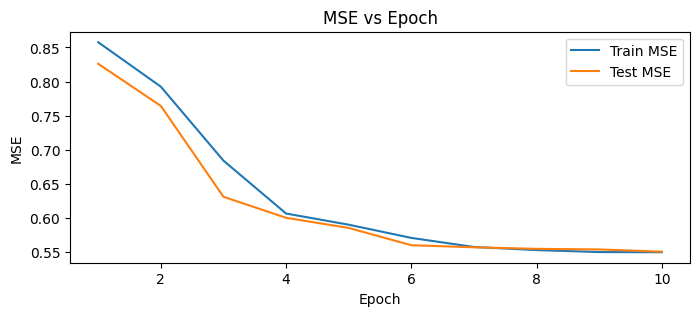

In [109]:
train_vae(model, train_loader, test_loader, epochs = nepochs, lr = lr, device = device)

### Test and Eval

In [93]:
# eval_profile = fixdis_profile
eval_profile = profile_alldata

In [110]:
mu_nui, logvar_nui, mu_coh , logvar_coh, c_mu_coh, c_logvar_coh = [],[],[],[],[],[]
sample_recon, sample_ori = [],[]
with torch.no_grad():
    for batch in groups:
        group_size = len(batch)
        # print(len(batch))
        batch = np.vstack(batch)
        batch = torch.from_numpy(batch).to(torch.float32)  
        # print(batch.shape)
        batch = batch.unsqueeze(0)
        batch = batch.unsqueeze(2)
        batch = batch.to(device)
        output = model(batch)
        mu_nui.append(output["mu_nui"].cpu())
        logvar_nui.append(output["logvar_nui"].cpu())
        mu_coh.append(output["mu_coh"].cpu())
        logvar_coh.append(output["logvar_coh"].cpu())
        recon = output["recon"]
        for i  in range(len(batch)):
            c_mu_coh.append(output["mu"][i*group_size , : model.encoderCoh.z_dim].cpu())
            c_logvar_coh.append(output["logvar"][i*group_size , : model.encoderCoh.z_dim].cpu())
        
        idx = random.randint(0, len(recon)-1)
        idx2 = random.randint(0, len(recon[0])-1)
        sample_recon_rf = recon[idx, idx2]
        sample_rf = batch[idx, idx2]
        # print(sample_recon_rf.shape, sample_rf.shape)
        sample_recon.append(sample_recon_rf)
        sample_ori.append(sample_rf)
        # break
sample_recon = torch.stack(sample_recon)
sample_ori = torch.stack(sample_ori)
sample_recon = sample_recon.squeeze(1).cpu()
sample_ori = sample_ori.squeeze(1).cpu()

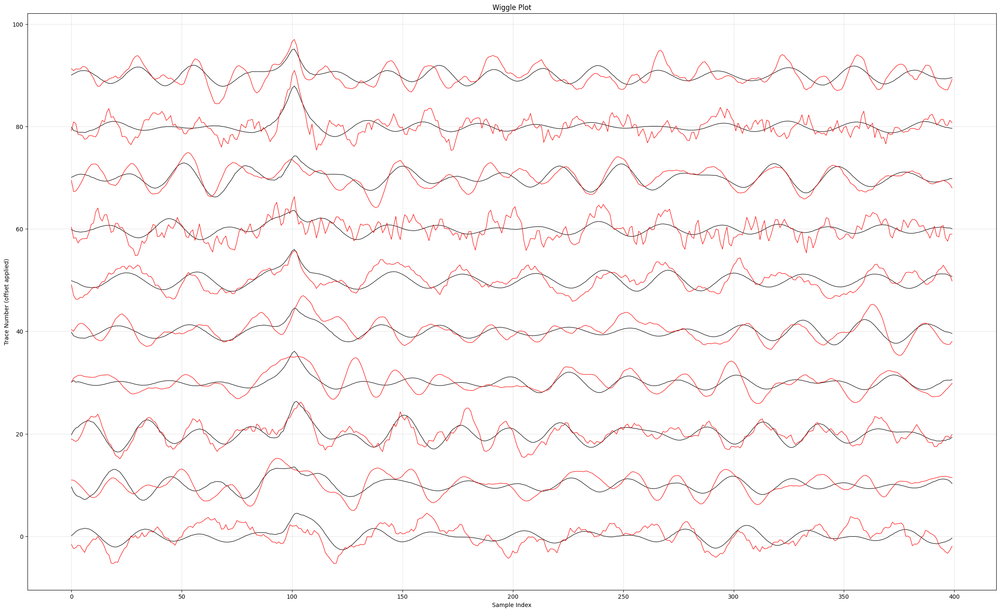

In [111]:
# Random n samples from test set are plotted
n_samples = 10
indices = sorted(random.sample(range(len(sample_recon)), n_samples))
plt.figure(figsize=(30, 18))
scaling = 2
spacing = 10  
for i,trace in enumerate(zip([sample_recon[i] for i in indices], [sample_ori[i] for i in indices])):
    # reconstructed in black
    plt.plot(trace[0]*scaling + i * spacing, color="black", linewidth=0.8)
    # original in red
    plt.plot(trace[1]*scaling + i * spacing, color = "red", linewidth = 0.8)

plt.xlabel("Sample Index")
plt.ylabel("Trace Number (offset applied)")
plt.title("Wiggle Plot")
plt.grid(True, alpha=0.3)
plt.show()

### Latent Space Testing

In [112]:
mu_coh = np.vstack(mu_coh)
logvar_coh = np.vstack(logvar_coh)
mu_nui = np.vstack(mu_nui)
logvar_nui = np.vstack(logvar_nui)
var_coh = np.exp(logvar_coh)
var_nui = np.exp(logvar_nui)
c_mu_coh = np.vstack(c_mu_coh)
c_logvar_coh = np.vstack(c_logvar_coh)
c_var_coh = np.exp(c_logvar_coh)

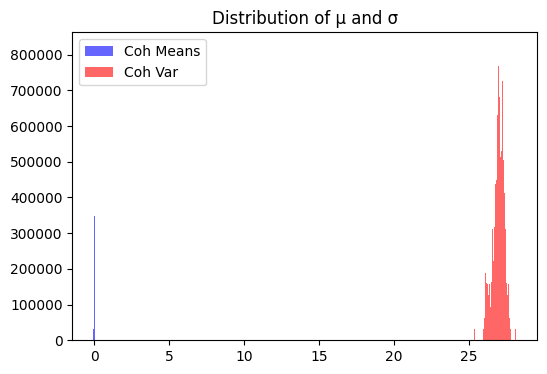

In [113]:
plt.figure(figsize=(6,4))
plt.hist(mu_coh.flatten(), bins=50, alpha=0.6, color="blue",   label="Coh Means")
plt.hist(var_coh.flatten(), bins=50, alpha=0.6, color="red",    label="Coh Var")
plt.legend()
plt.title("Distribution of μ and σ")
plt.show()

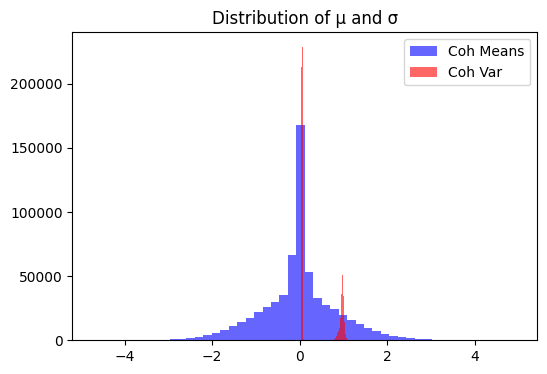

In [114]:
plt.figure(figsize=(6,4))
plt.hist(mu_nui.flatten(), bins=50, alpha=0.6, color="blue",   label="Coh Means")
plt.hist(var_nui.flatten(), bins=50, alpha=0.6, color="red",    label="Coh Var")
plt.legend()
plt.title("Distribution of μ and σ")
plt.show()

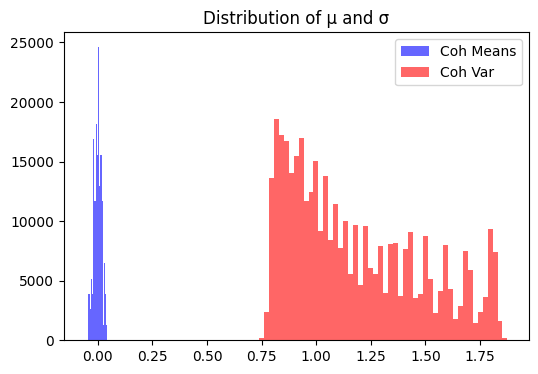

In [115]:
plt.figure(figsize=(6,4))
plt.hist(c_mu_coh.flatten(), bins=50, alpha=0.6, color="blue",   label="Coh Means")
plt.hist(c_var_coh.flatten(), bins=50, alpha=0.6, color="red",    label="Coh Var")
plt.legend()
plt.title("Distribution of μ and σ")
plt.show()

### Demeaning 

In [116]:
# Function to calculate KL divergence between nui code and corresponding coherent code
def kl_diag_normals(mu_coh, logvar_coh, mu_nui, logvar_nui):
    mu_coh = mu_coh.double()
    mu_nui = mu_nui.double()
    logvar_coh = logvar_coh.double()
    logvar_nui = logvar_nui.double()
    var_coh = torch.exp(logvar_coh)
    var_nui = torch.exp(logvar_nui)
    term = logvar_nui - logvar_coh + (var_coh + (mu_coh - mu_nui).pow(2)) / var_nui - 1.0
    kl = 0.5 * term.mean(dim=-1)
    return kl

In [117]:
#To find optimum nuisance code within our receiver function

min_kl = torch.tensor(float('inf'))
model.eval()
# bin_data = fixd
with torch.no_grad():
    for batch in list(eval_profile.bins.values()):
        batch = np.vstack(batch)
        batch = torch.from_numpy(batch).to(torch.float32)  
        # print(batch.shape)
        batch = batch.unsqueeze(0)
        batch = batch.unsqueeze(2)
        batch = batch.to(device)
        output = model(batch)
        mu = output["mu"]
        mu_coh = output["mu_coh"]
        mu_nui = output["mu_nui"]
        logvar = output["logvar"]
        logvar_coh = output["logvar_coh"]
        logvar_nui = output["logvar_nui"]
        # c_mu_coh = output["c_mu_coh"].squeeze(0)
        # c_logvar_coh = output["c_logvar_coh"].squeeze(0)
        c_mu_coh = output["mu"][0][: model.encoderCoh.z_dim]
        c_logvar_coh = output["logvar"][0][: model.encoderCoh.z_dim]
        
        # print(output["mu"].shape)
        c_mu_coh = c_mu_coh.repeat(len(batch[0]), 1)
        c_logvar_coh = c_logvar_coh.repeat(len(batch[0]), 1)
        # print(c_mu_coh.shape, mu_coh.shape, c_logvar_coh.shape)
        kl = kl_diag_normals(c_mu_coh, c_logvar_coh, mu_coh, logvar_coh)
        argmin =  torch.argmin(kl)
        if (kl[argmin] < min_kl):
            print(kl[argmin])
            min_kl = kl[argmin]
            opti_mu = mu_nui[argmin]
            opti_logvar = mu_nui[argmin]
        # break

tensor(1.2172, device='cuda:0', dtype=torch.float64)
tensor(1.2008, device='cuda:0', dtype=torch.float64)
tensor(1.1664, device='cuda:0', dtype=torch.float64)
tensor(1.1481, device='cuda:0', dtype=torch.float64)
tensor(1.1293, device='cuda:0', dtype=torch.float64)
tensor(1.1293, device='cuda:0', dtype=torch.float64)
tensor(1.1293, device='cuda:0', dtype=torch.float64)
tensor(1.1293, device='cuda:0', dtype=torch.float64)
tensor(1.1292, device='cuda:0', dtype=torch.float64)
tensor(1.1291, device='cuda:0', dtype=torch.float64)


In [118]:
model.eval()
from collections import defaultdict
bins_recon = defaultdict(list)
with torch.no_grad():
    for key, batch in list(eval_profile.bins.items()):
        batch_ = torch.tensor(batch, dtype=torch.float32)
        batch_ = batch_.to(device)
        batch_ = batch_.unsqueeze(0)
        batch_ = batch_.unsqueeze(2)
        batch_size, group_size, c, nt = batch_.size()
        batch_ = batch_.view(batch_size * group_size, c, nt)
        
        mu_coh, logvar_coh = model.encoderCoh(batch_)
        mu_coh_ = mu_coh.view(batch_size, group_size, model.encoderCoh.z_dim)
        logvar_coh_ = logvar_coh.view(batch_size, group_size, model.encoderCoh.z_dim)
        
        c_mu_coh, c_logvar_coh = model.accumulate_Gaussians(mu_coh_, logvar_coh_)
        
        c_mu_coh = c_mu_coh.view(model.encoderCoh.z_dim)
        c_logvar_coh = c_logvar_coh.view(model.encoderCoh.z_dim)
        
        mu = torch.cat([c_mu_coh, opti_mu], dim=0)
        logvar = torch.cat([c_logvar_coh, opti_logvar], dim=0)
        z = model.reparameterize(mu, logvar)
        z = z.view(batch_size, z.shape[0])
        recon = model.decoder(z) 
        recon = recon.view(model.nt)  
        bins_recon[key].append(recon.cpu().numpy())
        # break
        # print(key,type(batch), len(batch), batch_.shape, z.shape, recon.shape)     

In [119]:
recon_profile = RFProfileData()
recon_profile.bins = bins_recon

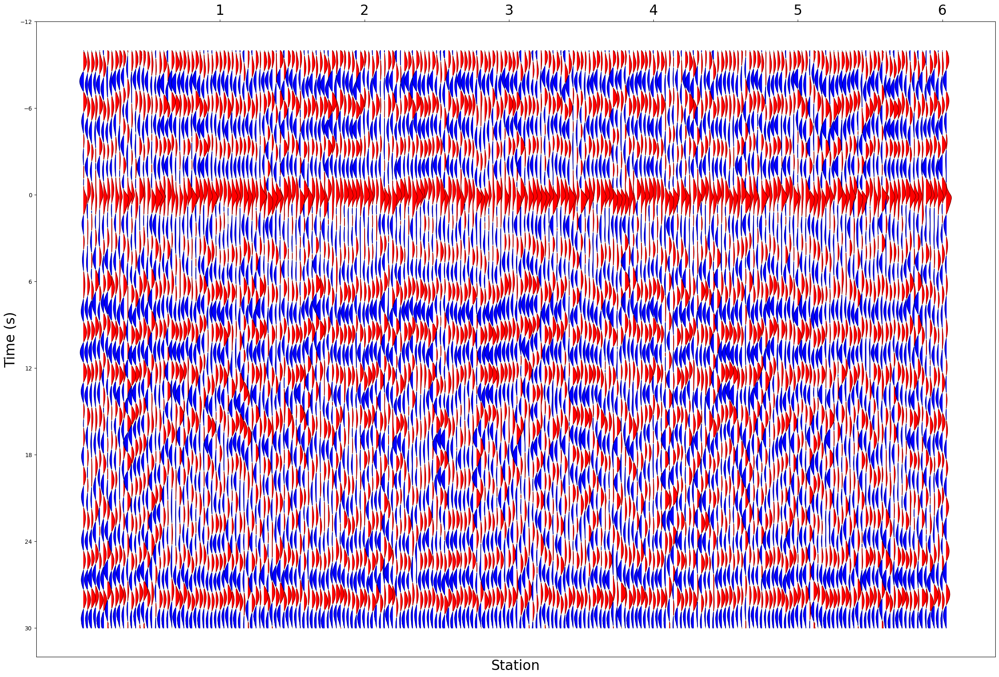

In [120]:
fig, ax = recon_profile._plot_binned_stacked(shift=10, time_after=30,nsamples = 400,scaling=2, spacing=5, figsize=(30, 20))
fig.patch.set_facecolor("white")
display(fig)

In [121]:
mean = np.mean(np.concatenate([arr for v in bins_recon.values() for arr in v]))
print(mean)

-0.009324014


In [122]:
model.eval()
from collections import defaultdict
bins_recon = defaultdict(list)
with torch.no_grad():
    for key, batch in list(eval_profile.bins.items()):
        batch_ = torch.tensor(batch, dtype=torch.float32)
        batch_ = batch_.to(device)
        batch_ = batch_.unsqueeze(0)
        batch_ = batch_.unsqueeze(2)
        batch_size, group_size, c, nt = batch_.size()
        batch_ = batch_.view(batch_size * group_size, c, nt)
        
        mu_coh, logvar_coh = model.encoderCoh(batch_)
        mu_coh_ = mu_coh.view(batch_size, group_size, model.encoderCoh.z_dim)
        logvar_coh_ = logvar_coh.view(batch_size, group_size, model.encoderCoh.z_dim)
        
        c_mu_coh, c_logvar_coh = model.accumulate_Gaussians(mu_coh_, logvar_coh_)
        
        c_mu_coh = c_mu_coh.view(model.encoderCoh.z_dim)
        c_logvar_coh = c_logvar_coh.view(model.encoderCoh.z_dim)
        
        mu = torch.cat([c_mu_coh, opti_mu], dim=0)
        logvar = torch.cat([c_logvar_coh, opti_logvar], dim=0)
        z = model.reparameterize(mu, logvar)
        z = z.view(batch_size, z.shape[0])
        recon = model.decoder(z) 
        recon = recon.view(400)  
        bins_recon[key].append(recon.cpu().numpy() - mean)
        # break
        # print(key,type(batch), len(batch), batch_.shape, z.shape, recon.shape)     

In [123]:
demean_profile = RFProfileData()
demean_profile.bins = bins_recon

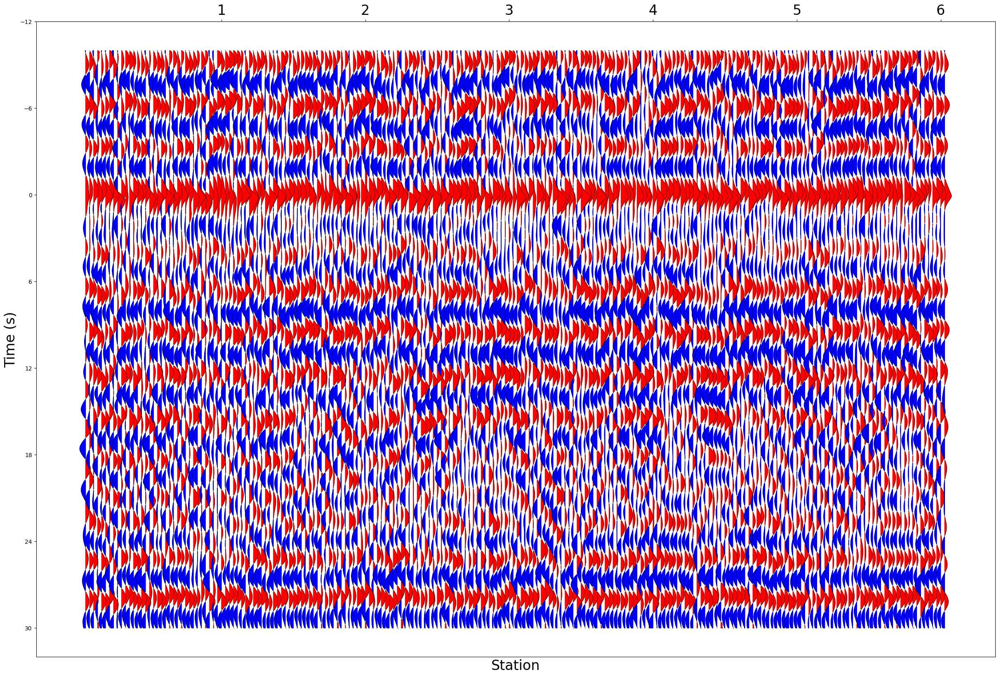

In [124]:
fig, ax = demean_profile._plot_binned_stacked(shift=10, time_after=30,nsamples = 400,scaling=3, spacing=5, figsize=(30, 20))
fig.patch.set_facecolor("white")
display(fig)